In [1]:
#import libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.model_selection import train_test_split


In [2]:
#importing dataset then read the dataset
df=pd.read_csv(r"C:\Users\91781\Downloads\archive (2)\data.csv")

In [3]:
#indentify the shape of the data
df.shape

(569, 33)

In [4]:
##used view the first few rows of a DataFrame.
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [6]:
#find the null values
df.isna().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [7]:
#
df.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


In [8]:
#count the total no.of positive or negative 
df['diagnosis'].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

In [9]:
#replacing the value of B with 0 and M with 1
df['diagnosis'].replace({"B":"0", "M":"1"}, inplace=True)

C:\Users\91781\AppData\Local\Temp\ipykernel_10116\2407347815.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['diagnosis'].replace({"B":"0", "M":"1"}, inplace=True)


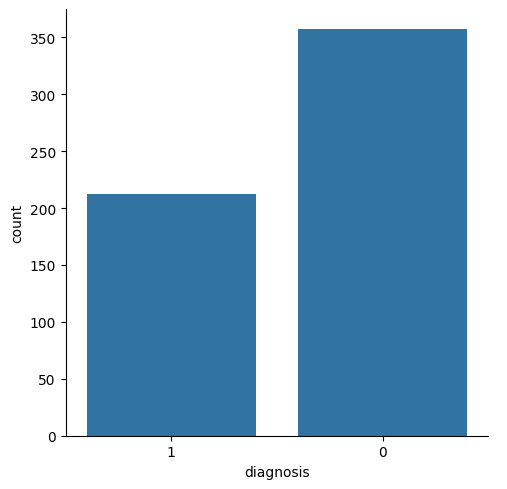

In [10]:
#visualize the dataset
sns.catplot(x='diagnosis', data=df, kind='count')

In [11]:
#dropping the value id and unnamed 32 from dataset
df.drop(['id','Unnamed: 32'],axis=1,inplace=True)

In [12]:
#converting diagnosis datatype from object to float
df['diagnosis']=df['diagnosis'].astype('float')

In [13]:
#describe that two variables are linearly related
correlation=df.corr()

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    float64
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

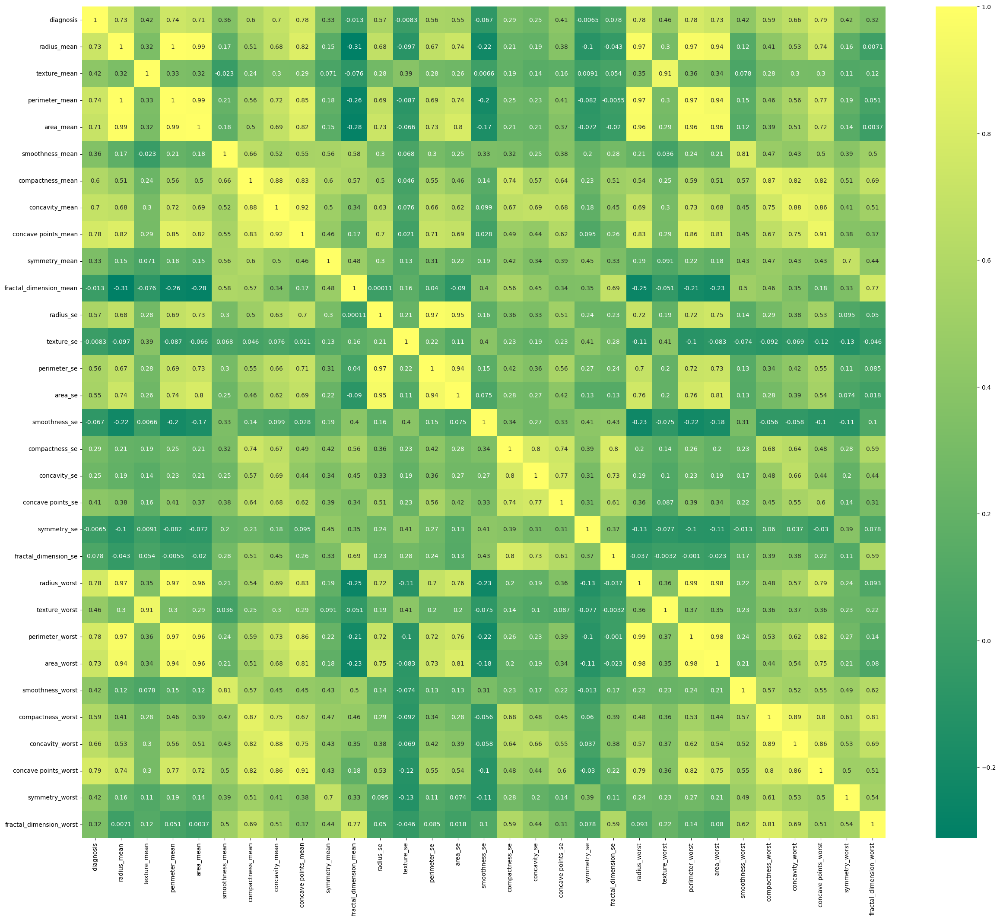

In [15]:
#plt.figure() is used to creates a new figure object 
plt.figure(figsize=(30,25))
#plot heapmap
#Heatmaps are visualization tool that uses color to represent the values in a matrix.
sns.heatmap(correlation,annot=True,cmap='summer')
plt.show()

In [16]:
plt.figure(figsize=(15,15))
#Pairplot is used to visualizing the relationship between multiple variables in a dataset.
sns.pairplot(df, diag_kind = "kde",  hue="diagnosis")
plt.show()

<Figure size 1500x1500 with 0 Axes>

In [17]:
# Identify outliers using the Z-score method
from scipy import stats
z_scores = np.abs(stats.zscore(df))

# Remove outliers 
dfr = df[(z_scores < 3).all(axis=1)]

In [18]:
#creating dependent and indenpendent variables 
x=dfr.drop('diagnosis',axis=1)
y=dfr['diagnosis']

In [19]:
#importing libaries
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC

In [20]:
#split dataset for 30% test and 70% train
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.3,random_state=0)

In [21]:
#normalize the dataset
st=StandardScaler()
x_train= st.fit_transform(x_train)
x_test= st.fit_transform(x_test)

In [22]:
#create svm and fit it
clf =SVC(kernel='rbf')
clf.fit(x_train,y_train)

SVC()

In [23]:
y_predict=clf.predict(x_test)

In [24]:
from sklearn import metrics
from sklearn.metrics import classification_report,confusion_matrix

In [25]:
print("Accuracy: ",metrics.accuracy_score(y_test,y_predict))
print()
print("Classfication Report: ",classification_report(y_test,y_predict))
print("COnfusion Matrix: ",confusion_matrix(y_test,y_predict))

Accuracy:  0.9798657718120806

Classfication Report:                precision    recall  f1-score   support

         0.0       0.98      0.99      0.99       102
         1.0       0.98      0.96      0.97        47

    accuracy                           0.98       149
   macro avg       0.98      0.97      0.98       149
weighted avg       0.98      0.98      0.98       149

COnfusion Matrix:  [[101   1]
 [  2  45]]


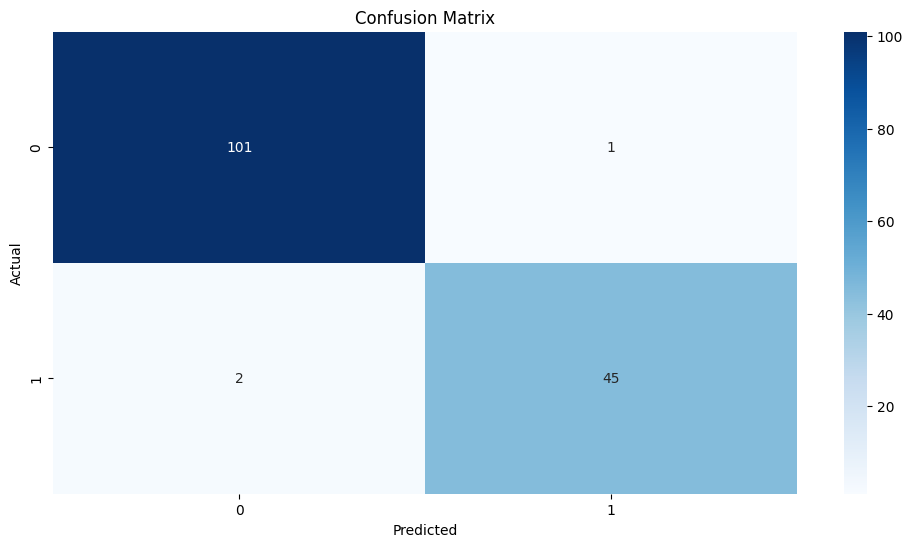

In [26]:
plt.figure(figsize=(12, 6))
cm = metrics.confusion_matrix(y_test, y_predict)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
# Plot heatmap
plt.title("Confusion Matrix")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

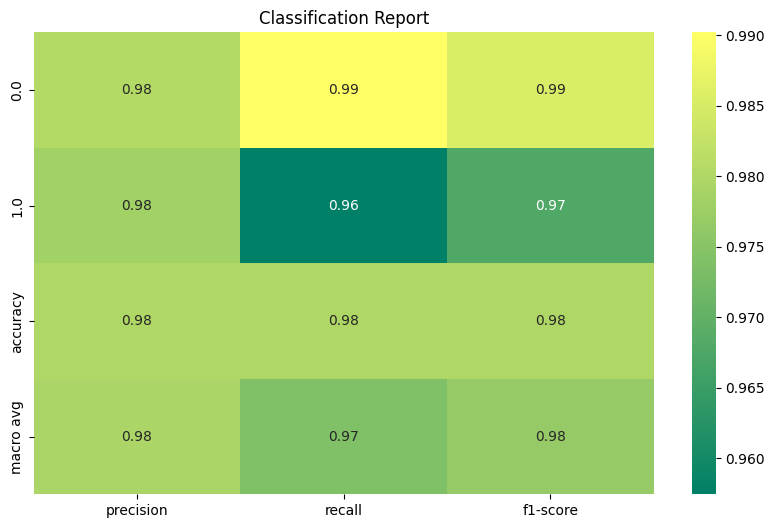

In [27]:
report = classification_report(y_test, y_predict, output_dict=True)
## Convert the report to a DataFrame(tabular form)
report_df = pd.DataFrame(report).transpose()
# Exclude the last row ('accuracy', 'macro avg', 'weighted avg')
metrics_to_plot = report_df[['precision', 'recall', 'f1-score']].iloc[:-1]
# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(metrics_to_plot, annot=True, cmap='summer', fmt='.2f')
plt.title('Classification Report')
plt.show()

In [28]:
#END